In [ ]:
"""
*Iteratively* minimize energy based on geometric relationships (similar to v10 but with improved methods)
"""

# Setup

## Imports

In [1]:
"""Normal estimation"""
ROOT_DIR = "/home/user/Documents/projects/Metaworld"

import sys
sys.path.append(ROOT_DIR)

%matplotlib widget  
import argparse
import gc
import os
import json
import random
from PIL import Image
from typing import Dict, List, Union

import cv2
import numpy as np

import gc
import matplotlib.pyplot as plt
import torch
from torchvision.transforms import PILToTensor
import torch.nn as nn
import numpy as np
import torch.nn.functional as F
from scipy.spatial.transform import Rotation as R
import importlib
from typing import List, Callable
from easydict import EasyDict as edict
from tqdm import tqdm

# visualization
import plotly.express as px
import plotly.graph_objects as go
from lightglue import viz2d
from einops import rearrange

import open3d as o3d
from open3d.web_visualizer import draw

Jupyter environment detected. Enabling Open3D WebVisualizer.
[Open3D INFO] WebRTC GUI backend enabled.
[Open3D INFO] WebRTCWindowSystem: HTTP handshake server disabled.
[Open3D INFO] Resetting default logger to print to terminal.


In [2]:
from keyframes.align_ft_spair import dataset
from keyframes.align_ft_spair.utils import (
    geo_utils,
    spair_utils,
    ft_align_utils,
    depth_match_utils,
    geom_utils,
    img_utils,
    kpt_likelihood_utils,
    kpt_likelihood_opt_v2,
    my_algorithm,
    focal_opt_utils,
    peak_extraction_utils,
)
from keyframes.align_ft_spair import pl_modules
from keyframes.align_ft_spair.ext import (
    projection_network,
    utils_correspondence,
    utils_dataset,
)
from utils import torch_utils, plotly_utils

## Data

In [3]:
# params
spair_data_folder="/media/user/ssd2t/datasets2/SPair-71k"
embds_folder_geo="/media/user/EXTREMESSD/datasets/SPair-71k/geo"
embds_folder_sd="/media/user/EXTREMESSD/datasets/SPair-71k/DiffusionFeatures60x60"
img_files_np_path_train="/home/user/Documents/projects/diffusion-features/experiments/ft_align/aeroplane_train_files_unique.npy"
img_files_np_path_eval="/home/user/Documents/projects/diffusion-features/experiments/ft_align/aeroplane_eval_files_unique.npy"
# depth_folder = "/media/user/EXTREMESSD/datasets/SPair-71k/miragold"
depth_folder = "/media/user/EXTREMESSD/datasets/SPair-71k/DepthAnythingV2"
masks_folder = "/media/user/EXTREMESSD/datasets/SPair-71k/SegAnyMasks"
focal_lengths_inv_file_train = "/home/user/Documents/projects/Metaworld/keyframes/align_ft_spair/notebooks/focal_length_opt_focal_lengths_inv_opt_v2.npy"
# kpt_indices=[3, 4, 5]
category="aeroplane"
img_size=960
embd_size=60
pad=True

img_files_train = np.load(img_files_np_path_train).tolist()
img_files_eval = np.load(img_files_np_path_eval).tolist()

flips_train = [False, True]
flips_eval = [False]

In [4]:
# load embeddings
img_embds_train, img_embds_hat_train = geo_utils.load_geo_embds(
    img_files_train,
    embds_folder_dino=embds_folder_geo,
    embds_folder_sd=embds_folder_sd,
    flips=flips_train,
)
img_embds_train = img_embds_train.detach().cpu()
img_embds_hat_train = img_embds_hat_train.detach().cpu()

# load embeddings
img_embds_eval, img_embds_hat_eval = geo_utils.load_geo_embds(
    img_files_eval,
    embds_folder_dino=embds_folder_geo,
    embds_folder_sd=embds_folder_sd,
    flips=flips_eval,
)
img_embds_eval = img_embds_eval.detach().cpu()
img_embds_hat_eval = img_embds_hat_eval.detach().cpu()

# build kpt_idx_to_kpt_embds
kpt_idx_to_kpt_embds_train, kpt_embd_coords_train, kpt_img_coords_train = spair_utils.build_kpt_idx_to_kpt_embds(
    img_files=img_files_train,
    img_embds_hat=img_embds_hat_train,
    spair_data_folder=spair_data_folder,
    img_size=img_size,
    embd_size=embd_size,
    pad=pad,
    flips=flips_train
)
kpt_idx_to_kpt_embds_eval, kpt_embd_coords_eval, kpt_img_coords_eval = spair_utils.build_kpt_idx_to_kpt_embds(
    img_files=img_files_eval,
    img_embds_hat=img_embds_hat_eval,
    spair_data_folder=spair_data_folder,
    img_size=img_size,
    embd_size=embd_size,
    pad=pad,
    flips=flips_eval
)

# average keypoint embeddings
kpt_features_avg_train = []
kpt_features_attn_avg_train = []
kpt_features_attn_sd_train = []
for kpt_idx in range(30):
    kpt_features = kpt_idx_to_kpt_embds_train[kpt_idx]
    # kpt_features is only None if keypoint label does not exist for object category
    if kpt_features is None:
        break

    if kpt_idx > 3 and kpt_idx < 22:
        kpt_idx_2 = kpt_idx + 1 if kpt_idx % 2 == 0 else kpt_idx - 1
        kpt_features_2 = kpt_idx_to_kpt_embds_train[kpt_idx_2]
        assert kpt_features_2 is not None, f"kpt_features is None for kpt_idx={kpt_idx_2}"
        kpt_features = torch.cat([kpt_features, kpt_features_2], dim=0)

    kpt_features_avg = torch.mean(kpt_features, dim=0, keepdim=True)  # (1, C)
    # compute dot product between kpt_features and kpt_features_avg
    kpt_features_attn = torch.bmm(kpt_features.unsqueeze(0), kpt_features_avg.unsqueeze(2)).squeeze(0)
    kpt_features_attn_avg = torch.mean(kpt_features_attn, dim=0, keepdim=True)
    kpt_features_attn_sd = torch.std(kpt_features_attn, dim=0, keepdim=True)
    kpt_features_avg_train.append(kpt_features_avg)
    kpt_features_attn_avg_train.append(kpt_features_attn_avg)
    kpt_features_attn_sd_train.append(kpt_features_attn_sd)

kpt_features_avg_train = torch.cat(kpt_features_avg_train, dim=0)
kpt_features_attn_avg_train = torch.cat(kpt_features_attn_avg_train, dim=0)
kpt_features_attn_sd_train = torch.cat(kpt_features_attn_sd_train, dim=0)
# print(kpt_features_avg_train.shape)

# 1.1) load depth
depths_train = []
for flip in flips_train:
    for img_file in img_files_train:
        fn = os.path.basename(img_file).split(".")[0]
        # depth_file = f"{depth_folder}/{category}/depth_npy/{fn}_pred.npy"
        depth_file = f"{depth_folder}/{category}/{fn}_depth.npy"
        depth = np.load(depth_file)
        # NEW for depth any: normalize and adjust z
        depth = 1 - 0.3*(depth/np.max(depth))
        if flip:
            depth = np.fliplr(depth)
        # NOTE instead of downsizing depth we will resize and upscale attentions
        depths_train.append(depth)

depths_eval = []
for flip in flips_eval:
    for img_file in img_files_eval:
        fn = os.path.basename(img_file).split(".")[0]
        # depth_file = f"{depth_folder}/{category}/depth_npy/{fn}_pred.npy"
        depth_file = f"{depth_folder}/{category}/{fn}_depth.npy"
        depth = np.load(depth_file)
        # NEW for depth any: normalize and adjust z
        depth = 1 - 0.3*(depth/np.max(depth))
        if flip:
            depth = np.fliplr(depth)
        depths_eval.append(depth)

# 1.3) reproject to point clouds
focal_lengths_inv_train = np.load(focal_lengths_inv_file_train)
# repeate focal lengths len(flips) times
focal_lengths_inv_train = np.repeat(focal_lengths_inv_train[None,:], len(flips_train), axis=0).flatten()
xyz_train = []
for i, depth in enumerate(depths_train):
    v0 = geom_utils.reproject_depth(depth, focal_length=1/focal_lengths_inv_train[i])
    xyz_train.append(v0)

xyz_eval = []
for depth in depths_eval:
    v0 = geom_utils.reproject_depth(depth)
    xyz_eval.append(v0)

# load segmentation masks
seg_masks_train = []
seg_auto_masks_train = []
for flip in flips_train:
    for img_file in img_files_train:
        fn = os.path.basename(img_file).split(".")[0]
        seg_mask_file = f"{masks_folder}/{category}/{fn}_masks.npy"
        seg_mask = np.load(seg_mask_file)
        if flip:
            for i in range(seg_mask.shape[0]):
                seg_mask[i] = np.fliplr(seg_mask[i])
        seg_masks_train.append(seg_mask)
        seg_auto_mask_file = f"{masks_folder}/{category}/{fn}_auto_masks_seg.npy"
        seg_auto_mask = np.load(seg_auto_mask_file)
        if flip:
            for i in range(seg_auto_mask.shape[0]):
                seg_auto_mask[i] = np.fliplr(seg_auto_mask[i])
        seg_auto_masks_train.append(seg_auto_mask)

# Compute Geometric Relationships

In [82]:
# 1) compute input args for optimization procedure
gt_kpt_xy_all_normalized, depth_values_all, gt_kpt_xyz_list, masks, kpt_coords_corrected_all = peak_extraction_utils.correct_all_keypoint_coords(
    img_seg_masks=seg_masks_train,
    kpt_img_coords=kpt_img_coords_train,
    img_xyz_orig=xyz_train
)

img_shapes = torch.zeros((gt_kpt_xy_all_normalized.shape[0], 2))
for i in range(gt_kpt_xy_all_normalized.shape[0]):
    img_shapes[i,:] = torch.tensor(xyz_train[i].shape[:2])

gt_kpt_xy_all_normalized_no_nan = gt_kpt_xy_all_normalized.clone()
gt_kpt_xy_all_normalized_no_nan[torch.isnan(gt_kpt_xy_all_normalized_no_nan)] = 0.0
depth_values_all_no_nan = depth_values_all.clone()
depth_values_all_no_nan[torch.isnan(depth_values_all_no_nan)] = 0.0

vertex_mask = focal_opt_utils.generate_is_not_nan_mask(gt_kpt_xy_all_normalized)

100%|██████████| 110/110 [00:00<00:00, 425.23it/s]


In [83]:
# reproject all points with optimised focal length
kpts_xyz_all = focal_opt_utils.reproject_kpts(
    focal_lenghts_inv=torch.abs(torch_utils.to_torch_tensor(focal_lengths_inv_train, device="cpu")),
    img_shapes=img_shapes,
    kpt_xy_normalized=gt_kpt_xy_all_normalized_no_nan,
    kpt_depth=depth_values_all_no_nan,
)

In [84]:
# compute statistics
angles_mask, ratios_mask = focal_opt_utils.generate_angle_and_ratio_mask(vertex_mask)
cos_angles, angles, ratios = kpt_likelihood_utils.compute_angles_and_ratios_parallel(kpts_xyz_all)
cos_angles_mean, cos_angles_var, ratios_mean, ratios_var = kpt_likelihood_utils.compute_stats_over_images(
    cos_angles, ratios, angles_mask, ratios_mask
)

In [85]:
# set cos_angles_mean/var and ratios_mean/var to torch.nan as mask
# we only consider 
angle_counts = torch.sum(angles_mask, dim=0)
ratio_counts = torch.sum(ratios_mask, dim=0)
# only consider angles and ratios with more than 20 samples
m_angles = (angle_counts > 3)# & (cos_angles_var > 0.01)
m_ratios = (ratio_counts > 3)# & (ratios_var > 0.01)
# cos_angles_mean[~m_angles] = torch.nan
# cos_angles_var[~m_angles] = torch.nan
# ratios_mean[~m_ratios] = torch.nan
# ratios_var[~m_ratios] = torch.nan

cos_angles_var = torch.clip(cos_angles_var, min=0.02, max=1.0)
ratios_var = torch.clip(ratios_var, min=0.02, max=1.0)

# cos_angles_var_no_zero = cos_angles_var.reshape(-1)
# cos_angles_var_no_zero[cos_angles_var_no_zero < 1e-3] = torch.inf
# cos_angles_var_sorted, cos_angles_var_indices = torch.sort(torch.abs(cos_angles_var_no_zero / (signed_volumes_mean + 1e-6)), descending=False)


In [86]:
# signed volumes
pseudo_kpt_xyz = torch.zeros((vertex_mask.shape[0], vertex_mask.shape[1], 3))
pseudo_kpt_xyz[~vertex_mask,:] = torch.nan
pseudo_signed_volumes = kpt_likelihood_utils.compute_signed_volumes_parallel(pseudo_kpt_xyz)
signed_volumes_mask = ~torch.isnan(pseudo_signed_volumes)
signed_volumes = kpt_likelihood_utils.compute_signed_volumes_parallel(kpts_xyz_all)
signed_volumes_var, signed_volumes_mean = torch_utils.masked_var_mean(signed_volumes, signed_volumes_mask)

devices cpu cpu
devices cpu cpu


In [87]:
# take tet combinations with highest occurence
tet_img_counts = torch.sum(signed_volumes_mask, dim=0)
# tet_img_counts_sorted, tet_img_counts_sorted_indices = torch.sort(tet_img_counts, descending=True)

# only keep combinations with low variance
max_num_combinations = 1000
# signed_volumes_var_sorted, signed_volumes_var_indices = torch.sort(torch.abs(signed_volumes_var / (signed_volumes_mean + 1e-6)), descending=False)
# masked_tet_combinations = (signed_volumes_var > 0) & (signed_volumes_var < signed_volumes_var_sorted[max_num_combinations])
# signed_volumes_var = signed_volumes_var[masked_tet_combinations]
# signed_volumes_mean = signed_volumes_mean[masked_tet_combinations]


# signed_volumes_mean_sorted, signed_volumes_mean_indices = torch.sort(torch.abs(signed_volumes_mean), descending=True)

# ignore volumes where var is too small
signed_volumes_var_no_zero = signed_volumes_var.clone()
signed_volumes_var_no_zero[torch.abs(signed_volumes_var) < 1e-3] = torch.inf
# only consider signed volumes with high occurence
signed_volumes_var_no_zero[tet_img_counts < 20] = torch.inf
signed_volumes_var_sorted, signed_volumes_var_indices = torch.sort(torch.abs(signed_volumes_var_no_zero / (signed_volumes_mean + 1e-6)), descending=False)

masked_tet_combinations = torch.zeros(signed_volumes_var.shape, dtype=torch.bool)
masked_tet_combinations[signed_volumes_var_indices[:max_num_combinations]] = True

signed_volumes_var = signed_volumes_var[masked_tet_combinations]
signed_volumes_mean = signed_volumes_mean[masked_tet_combinations]

print(torch.min(signed_volumes_var), torch.min(torch.abs(signed_volumes_mean)), print(signed_volumes_var.shape))

torch.Size([1000])
tensor(0.0010) tensor(0.0066) None


In [ ]:
# with torch.autograd.profiler.profile(use_cuda=True) as prof:
#     torch.det(matrices)
# print(prof)

In [ ]:
# fname_focal_length_opt_cos_angles_mean = "/home/user/Documents/projects/Metaworld/keyframes/align_ft_spair/notebooks/focal_length_opt_cos_angles_mean.npy"
# fname_focal_length_opt_cos_angles_var = "/home/user/Documents/projects/Metaworld/keyframes/align_ft_spair/notebooks/focal_length_opt_cos_angles_var.npy"
# fname_focal_length_opt_ratios_mean = "/home/user/Documents/projects/Metaworld/keyframes/align_ft_spair/notebooks/focal_length_opt_ratios_mean.npy"
# fname_focal_length_opt_ratios_var = "/home/user/Documents/projects/Metaworld/keyframes/align_ft_spair/notebooks/focal_length_opt_ratios_var.npy"
# cos_angles_mean = torch_utils.to_torch_tensor(np.load(fname_focal_length_opt_cos_angles_mean), device="cpu")
# cos_angles_var = torch_utils.to_torch_tensor(np.load(fname_focal_length_opt_cos_angles_var), device="cpu")
# ratios_mean = torch_utils.to_torch_tensor(np.load(fname_focal_length_opt_ratios_mean), device="cpu")
# ratios_var = torch_utils.to_torch_tensor(np.load(fname_focal_length_opt_ratios_var), device="cpu")

# Method

In [107]:
imi = 0

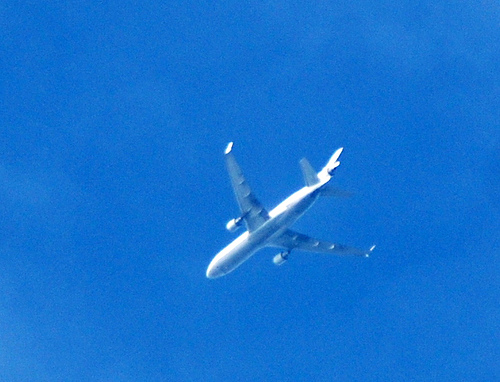

In [125]:
img_idx=imi
imi += 1
Image.open(img_files_train[img_idx])

In [75]:
px.imshow(np.array(Image.open(img_files_train[img_idx])))

In [126]:
# extract candidates for keypoints
max_candidates = 30

# copmute likelihood of keypoint label for each image patch
img_kpt_label_likelihood = kpt_likelihood_utils.compute_kpt_label_likelihood(
    img_embd_hat=img_embds_hat_train[img_idx],
    kpt_embd_hat_mean=kpt_features_avg_train,
    kpt_attn_mean=kpt_features_attn_avg_train[:,0],
    kpt_attn_sd=kpt_features_attn_sd_train[:,0]
)

In [127]:
candidates_xyz, candidates_xy, candidate_kpt_likelihoods, candidates_embd_coords_xy = peak_extraction_utils.extract_candidates(
    img_xyz_orig=xyz_train[img_idx],
    img_seg_mask=seg_masks_train[img_idx][2],
    img_kpt_label_likelihood=img_kpt_label_likelihood,
    min_distance=6,
    min_peak_value=0.01,
    max_candidates=30,
    peak_rel_threshold=0.2
)
img_np = np.array(Image.open(img_files_train[img_idx]))
img_np = np.concatenate([img_np, 125*np.ones((img_np.shape[0], img_np.shape[1], 1), dtype=np.uint8)], axis=2)
img_np[candidates_xy[:,1], candidates_xy[:,0],:] = (255,0,0,255)
px.imshow(img_np)

In [91]:
# for i in range(candidates_xy.shape[0]):
#     print(i, candidates_xy[i], candidate_kpt_likelihoods[i].item())
# 11: 38, 7: 44

In [141]:
candidate_kpt_label_likelihood = img_kpt_label_likelihood[:, candidates_embd_coords_xy[:,1], candidates_embd_coords_xy[:,0]]
candidate_kpt_label_likelihood /= torch.max(candidate_kpt_label_likelihood, dim=1).values[:,None]

In [93]:
# px.imshow(candidate_kpt_label_likelihood)

In [94]:
# img_likelihood_of_kpt_up = img_utils.inv_pad_resize_img(img_kpt_label_likelihood[11], *xyz_train[img_idx].shape[:2])
# px.imshow(img_likelihood_of_kpt_up + xyz_train[img_idx][:,:,2])

In [95]:
# target_xyz = candidates_xyz[[44, 43, 0, 38, 39]] # 2,4, # , 22, 24 # , 0, 22
# target_kpt_labels = torch.tensor([0, 1, 23, 2, 3]) # 1,3, # , 19, 24 # , 23, 8

In [96]:
# candidate_model_likelihood = my_algorithm.compute_candidate_internal_model_energy(
#     candidates_xyz=candidates_xyz,
#     target_xyz=target_xyz,
#     target_kpt_labels=target_kpt_labels,
#     kpt_cos_angles_mean=cos_angles_mean,
#     kpt_cos_angles_var=cos_angles_var,
#     kpt_ratios_mean=ratios_mean,
#     kpt_ratios_var=ratios_var,
#     signed_volumes_mean=signed_volumes_mean,
#     signed_volumes_var=signed_volumes_var
# )

In [97]:
# total_likelihood = torch.exp(candidate_model_likelihood) * candidate_kpt_label_likelihood
# total_likelihood[target_kpt_labels] = 0
# sums = torch.sum(total_likelihood, dim=0)
# sums[sums == 0] = 1
# ambiguity = total_likelihood / sums
# total_likelihood *= ambiguity

In [98]:
def my_simple_algo(
    candidates_xyz: torch.Tensor,
    chosen_candidates: List[int],
    chosen_kpt_labels: List[int],
    chosen_likelihoods: List[float],
    candidate_kpt_label_likelihood: torch.Tensor,
    cos_angles_mean: torch.Tensor,
    cos_angles_var: torch.Tensor,
    ratios_mean: torch.Tensor,
    ratios_var: torch.Tensor,
    signed_volumes_mean: torch.Tensor,
    signed_volumes_var: torch.Tensor,
    stop_thresh: float,
    err_thresh: float,
    compute_signed_volumes_parallel: Callable[[torch.Tensor], torch.Tensor],
):
    assert len(chosen_candidates) == len(chosen_kpt_labels), "len(chosen_candidates) != len(chosen_kpt_labels)"
    device = candidates_xyz.device
    target_xyz = candidates_xyz[chosen_candidates]
    target_kpt_labels = torch.tensor(chosen_kpt_labels, dtype=torch.long, device=device)
    
    candidate_model_likelihood = my_algorithm.compute_candidate_internal_model_energy(
        candidates_xyz=candidates_xyz,
        target_xyz=target_xyz,
        target_kpt_labels=target_kpt_labels,
        kpt_cos_angles_mean=cos_angles_mean,
        kpt_cos_angles_var=cos_angles_var,
        kpt_ratios_mean=ratios_mean,
        kpt_ratios_var=ratios_var,
        signed_volumes_mean=signed_volumes_mean,
        signed_volumes_var=signed_volumes_var,
        compute_signed_volumes_parallel=compute_signed_volumes_parallel
    )

    total_likelihood = candidate_model_likelihood * candidate_kpt_label_likelihood
    total_likelihood[target_kpt_labels] = 0
    sums = torch.sum(total_likelihood, dim=0)
    sums[sums == 0] = 1
    ambiguity = total_likelihood / sums
    total_likelihood *= ambiguity

    total_likelihood_max_res = torch.max(total_likelihood, dim=1)  # (k,)
    total_likelihood_max = total_likelihood_max_res.values
    total_likelihood_max_idx = total_likelihood_max_res.indices

    # print("likelihood of 11 at 38", candidate_model_likelihood[11,38], candidate_kpt_label_likelihood[11,38])
    # print("likelihood of 7 at 44", candidate_model_likelihood[7,44], candidate_kpt_label_likelihood[7,44])
    # print("total_likelihood_max[11]",total_likelihood_max[[10,11]])

    next_kpt_index = torch.argmax(total_likelihood_max)
    next_candidate_index = int(total_likelihood_max_idx[next_kpt_index].item())
    next_kpt_likelihood_max = total_likelihood_max[next_kpt_index]
    if total_likelihood_max[next_kpt_index] < stop_thresh:
        return chosen_candidates, chosen_kpt_labels, chosen_likelihoods

    kpt_indices = torch.arange(total_likelihood.shape[0], device=device)
    next_kpt_indices = kpt_indices[total_likelihood[:,next_candidate_index] > next_kpt_likelihood_max * err_thresh]
    print(next_kpt_indices)
    print("========================")
    max_likelihood = 0
    new_chosen_candidates_max = []
    new_chosen_kpt_labels_max = []
    new_chosen_likelihoods_max = []
    for kpt_index in next_kpt_indices:
        candidate_idx = int(total_likelihood_max_idx[kpt_index].item())
        new_chosen_candidates = chosen_candidates + [candidate_idx]
        new_chosen_kpt_labels = chosen_kpt_labels + [int(kpt_index.item())]
        new_chosen_likelihoods = chosen_likelihoods + [total_likelihood_max[kpt_index].item()]
        print("-------------------")
        print("entering", kpt_index)
        print("-------------------")
        new_chosen_candidates, new_chosen_kpt_labels, new_chosen_likelihoods = my_simple_algo(
            candidates_xyz=candidates_xyz,
            chosen_candidates=new_chosen_candidates,
            chosen_kpt_labels=new_chosen_kpt_labels,
            chosen_likelihoods=new_chosen_likelihoods,
            candidate_kpt_label_likelihood=candidate_kpt_label_likelihood,
            cos_angles_mean=cos_angles_mean,
            cos_angles_var=cos_angles_var,
            ratios_mean=ratios_mean,
            ratios_var=ratios_var,
            signed_volumes_mean=signed_volumes_mean,
            signed_volumes_var=signed_volumes_var,
            stop_thresh=stop_thresh,
            err_thresh=err_thresh,
            compute_signed_volumes_parallel=compute_signed_volumes_parallel
        )
        likelihood = torch.sum(torch.tensor(new_chosen_likelihoods))
        if likelihood > max_likelihood:
            max_likelihood = likelihood
            new_chosen_candidates_max = new_chosen_candidates
            new_chosen_kpt_labels_max = new_chosen_kpt_labels
            new_chosen_likelihoods_max = new_chosen_likelihoods
    return new_chosen_candidates_max, new_chosen_kpt_labels_max, new_chosen_likelihoods_max

In [119]:
importlib.reload(my_algorithm)

<module 'keyframes.align_ft_spair.utils.my_algorithm' from '/home/user/Documents/projects/Metaworld/keyframes/align_ft_spair/utils/my_algorithm.py'>

In [142]:
device="cuda"
candidates_xyz=candidates_xyz.to(device)
# target_xyz=target_xyz.to(device)
# target_kpt_labels=target_kpt_labels.to(device)
cos_angles_mean=cos_angles_mean.to(device)
cos_angles_var=cos_angles_var.to(device)
ratios_mean=ratios_mean.to(device)
ratios_var=ratios_var.to(device)
signed_volumes_mean=signed_volumes_mean.to(device)
signed_volumes_var=signed_volumes_var.to(device)
candidate_kpt_label_likelihood = candidate_kpt_label_likelihood.to(device)

In [143]:
px.imshow(candidate_kpt_label_likelihood.cpu())

In [147]:
k, c = candidate_kpt_label_likelihood.shape
compute_signed_volumes_parallel, _, _, _ = kpt_likelihood_utils.get_compute_signed_volumes_parallel_fn(
    device="cuda",
    batch_size=k*c,
    n_vertices_per_batch=k,
    masked_combinations=masked_tet_combinations,
)
new_chosen_candidates_max, new_chosen_kpt_labels_max, new_chosen_likelihoods_max = my_simple_algo(
    candidates_xyz=candidates_xyz,
    chosen_candidates=[],
    chosen_kpt_labels=[],
    chosen_likelihoods=[],
    candidate_kpt_label_likelihood=candidate_kpt_label_likelihood,
    cos_angles_mean=cos_angles_mean,
    cos_angles_var=cos_angles_var,
    ratios_mean=ratios_mean,
    ratios_var=ratios_var,
    signed_volumes_mean=signed_volumes_mean,
    signed_volumes_var=signed_volumes_var,
    stop_thresh=0.001,
    err_thresh=0.3,
    compute_signed_volumes_parallel=compute_signed_volumes_parallel
)

tensor([0], device='cuda:0')
-------------------
entering tensor(0, device='cuda:0')
-------------------
tensor([2], device='cuda:0')
-------------------
entering tensor(2, device='cuda:0')
-------------------
devices cuda:0 cuda:0
tensor([1], device='cuda:0')
-------------------
entering tensor(1, device='cuda:0')
-------------------
devices cuda:0 cuda:0
tensor([23], device='cuda:0')
-------------------
entering tensor(23, device='cuda:0')
-------------------
devices cuda:0 cuda:0
tensor([22], device='cuda:0')
-------------------
entering tensor(22, device='cuda:0')
-------------------
devices cuda:0 cuda:0
tensor([10], device='cuda:0')
-------------------
entering tensor(10, device='cuda:0')
-------------------
devices cuda:0 cuda:0
tensor([6], device='cuda:0')
-------------------
entering tensor(6, device='cuda:0')
-------------------
devices cuda:0 cuda:0
tensor([14], device='cuda:0')
-------------------
entering tensor(14, device='cuda:0')
-------------------
devices cuda:0 cuda:

In [148]:
new_chosen_kpt_labels_max

[0, 2, 1, 23, 22, 10, 6, 14, 9, 15, 13, 7, 8, 12, 18]

In [70]:
new_chosen_kpt_labels_max.sort()
new_chosen_kpt_labels_max

[0, 1, 2, 3]

In [137]:
kpt_img_coords_train[img_idx][:,2].numpy().tolist()

[0, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 23, 24]

In [195]:
len(kpt_img_coords_train[img_idx][:,2].numpy().tolist())

18

In [149]:
img_xyz = xyz_train[img_idx]
img_xyz_flat = img_xyz.reshape((-1,3))
kpt_labels = kpt_img_coords_train[img_idx][:,2].numpy()
kpts_xyz = kpts_xyz_all[img_idx][kpt_labels]

# scatter = go.Scatter3d(
#     x=kpts_xyz[:,0],
#     y=kpts_xyz[:,1],
#     z=kpts_xyz[:,2],
#     mode='markers',
#     marker=dict(
#         size=6,
#         color=px.colors.qualitative.Alphabet,
#         # color=z,  # set color to an array/list of desired values
#         # colorscale='Viridis',  # choose a colorscale
#         opacity=0.8
#     ),
#     hovertext=[f"{i}" for i in kpt_labels]
# )

scatter2 = go.Scatter3d(
    x=img_xyz_flat[:,0],
    y=img_xyz_flat[:,1],
    z=img_xyz_flat[:,2],
    mode='markers',
    marker=dict(
        size=1,
        color="black",
        # color=z,  # set color to an array/list of desired values
        # colorscale='Viridis',  # choose a colorscale
        opacity=0.8
    ),
    # hovertext=[f"{i}" for i in kpt_labels]
)
sccater3 = go.Scatter3d(
    x=candidates_xyz[new_chosen_candidates_max,0].cpu(),
    y=candidates_xyz[new_chosen_candidates_max,1].cpu(),
    z=candidates_xyz[new_chosen_candidates_max,2].cpu(),
    mode='markers',
    marker=dict(
        size=6,
        color=px.colors.qualitative.Alphabet,
        # color=z,  # set color to an array/list of desired values
        # colorscale='Viridis',  # choose a colorscale
        opacity=0.8
    ),
    hovertext=[f"{i}" for i in new_chosen_kpt_labels_max]
)

fig = go.FigureWidget(data=[scatter2, sccater3]) # scatter_img_xyz_orig
fig.update_layout(margin=dict(l=0, r=0, b=0, t=0), scene_aspectmode='data')
fig.show()

In [39]:
importlib.reload(my_algorithm)

<module 'keyframes.align_ft_spair.utils.my_algorithm' from '/home/user/Documents/projects/Metaworld/keyframes/align_ft_spair/utils/my_algorithm.py'>

In [ ]:
# extract candidate keypoint label likelihood


# update candidate keypoint label likelihood with model energy given a set of chosen candidates and keypoints
# kpt_label_likelihood * model_likelihood * ambiguity?

# take candidate with highest likelihood?




In [63]:
candidates_xy.shape

torch.Size([33, 2])

## Testing

### compute_candidate_internal_model_energy

# Evaluation

In [ ]:
# for reference see: keyframes/align_ft_spair/notebooks/eval_spair-71k_v3.ipynb

In [ ]:
# 1) find eval focal lengths
focal_lengths_eval = ...

# 1.1) reproject all points with optimised focal length
xyz_eval = ...

# 2) compute kpt label likelihoods for img
img_kpt_label_likelihoods_train = ...
img_kpt_label_likelihoods_eval = ...

# 2) extract candidates for all train and eval images
candidates_xyz_train = ...
candidates_xyz_eval = ...

# 3) extract candidate label likelihoods
candidate_kpt_label_likelihoods_train = ...
candidate_kpt_label_likelihoods_eval = ...

# 3) pick and assign labels to candidates
chosen_candidates_train = ...
chosen_kpt_labels_train = ...
chosen_likelihoods_train = ...
chosen_candidates_eval = ...
chosen_kpt_labels_eval = ...
chosen_likelihoods_eval = ...

In [ ]:
from http.client import REQUEST_URI_TOO_LONG


def map_point(
    query_xyz: torch.Tensor,
    query_kpt_label_likelihood: torch.Tensor,
    candidates_xyz: torch.Tensor,
    candidates_kpt_label_likelihood: torch.Tensor,
    src_kpts_xyz: torch.Tensor,
    tgt_kpts_xyz: torch.Tensor
):
    """
    Args:
        # NOTE 
        query_xyz: (Q, 3) query point in source image
        query_kpt_label_likelihood: (K, Q)
        candidates_xyz: (C, 3) candidate points in target image
        candidates_kpt_label_likelihood: (K, C)
        src_kpts_xyz: (K, 3)
        tgt_kpts_xyz: (K, 3)
    """

    # compute distance to kpts for each query/candidate point
    dists_src = torch.cdist(query_xyz, src_kpts_xyz, p=2)  # (Q, K)
    dists_tgt = torch.cdist(candidates_xyz, tgt_kpts_xyz, p=2)  # (C, K)

    # ratios
    # TODO ratio is one if dists_tgt is zero
    ratios = dists_src[:,None,:] / (dists_src[:,None,:] + dists_tgt[None,:,:] + 1e-9)  # (Q, C, k)
    ratios[torch.isnan(ratios)] = 1
    ratio_vars = torch.var(ratios, dim=2)  # (Q, C)

    # label likelihood squared difference
    label_likelihood_diff = query_kpt_label_likelihood[:,None,:] - candidates_kpt_label_likelihood[None,:,:]  # (Q, C, K)
    label_likelihood_diff = torch.sum(label_likelihood_diff**2, dim=2)  # (Q, C)

    # energy
    energy = ratio_vars + label_likelihood_diff

    # select candidate with lowest energy
    min_energy = torch.min(energy, dim=1)  # (Q,)
    return min_energy.indices, min_energy.values

In [ ]:
def input_args_loader(img_fn):
    # 1) candidates_xyz
    candidates_xyz = ...
    # 2) candidate_kpt_label_likelihood
    candidate_kpt_label_likelihood = ...
    # 3) compute_signed_volumes_parallel
    k, c = candidate_kpt_label_likelihood.shape
    compute_signed_volumes_parallel, batch_indices, combinations_expanded, ones = kpt_likelihood_utils.get_compute_signed_volumes_parallel_fn(
        device="cuda",
        batch_size=k*c,
        n_vertices_per_batch=k,
        masked_combinations=masked_tet_combinations,
    )

    # assign kpt labels to selection of candidates
    new_chosen_candidates_max, new_chosen_kpt_labels_max, new_chosen_likelihoods_max = my_simple_algo(
        candidates_xyz=candidates_xyz,
        chosen_candidates=[],
        chosen_kpt_labels=[],
        chosen_likelihoods=[],
        candidate_kpt_label_likelihood=candidate_kpt_label_likelihood,
        cos_angles_mean=cos_angles_mean,
        cos_angles_var=cos_angles_var,
        ratios_mean=ratios_mean,
        ratios_var=ratios_var,
        signed_volumes_mean=signed_volumes_mean,
        signed_volumes_var=signed_volumes_var,
        stop_thresh=0.00001,
        err_thresh=0.3,
        compute_signed_volumes_parallel=compute_signed_volumes_parallel
    )
    return candidates_xyz, candidate_kpt_label_likelihood, compute_signed_volumes_parallel

In [ ]:
def compute_geom_relationship(kpt_xyz, query_xyz):
    """
    Args:
        - kpt_xyz: (k, 3) kpt_xyz[i] is nan if not existent
        - query_xyz: (n, 3)
    """
    dists = torch.cdist(query_xyz, kpt_xyz, p=2)  # (n, k)

In [ ]:
def find_correspondence(
    query_xy, 
    query_features_hat, 
    src_img_xyz, 
    src_kpt_xyz, 
    tgt_img_embd_hat, 
    tgt_img_xyz, 
    tgt_kpt_xyz
):
    # correct query xy coordinates


    # extract depth

    # transform to embd coordinates


    # extract kpt label likelihood


    # => make sure label likelihoods are similar


    # find point in target image that best matches geometric relationships and lieklihood
    dists_src = torch.cdist(query_xyz, src_kpt_xyz, p=2)  # (n, k)
    tgt_candidates_xyz = tgt_img_xyz.reshape((-1, 3))
    tgt_candidates_xy = ...
    
    
    h_orig, w_orig = img_xyz_orig.shape[:2]
    embd_size = img_likelihood_of_kpt.shape[-1]
    img_likelihood_of_kpt_up = img_utils.inv_pad_resize_img(img_likelihood_of_kpt, h_orig, w_orig)
    peak_xy_coords, peak_values = ft_align_utils.extract_local_maxima(img_likelihood_of_kpt_up, k=max_num_peaks, min_distance=min_distance)



    dists_tgt = torch.cdist(tgt_candidates_xyz, tgt_kpt_xyz, p=2)  # (m, k)

    # ratios
    ratios = dists_src[:,None,:] / (dists_src[:,None,:] + dists_tgt[None,:,:])  # (n, m, k)
    ratio_vars = torch.var(ratios, dim=2)  # (n, m)

    src_img_kpt_label_likelihood = ...
    tgt_img_kpt_label_likelihood = kpt_likelihood_utils.compute_kpt_label_likelihood(
        img_embd_hat=tgt_img_embd_hat,
        kpt_embd_hat_mean=kpt_features_avg_train,
        kpt_attn_mean=kpt_features_attn_avg_train[:,0],
        kpt_attn_sd=kpt_features_attn_sd_train[:,0]
    )
    pass


In [ ]:
def predict(img1_query_coords, args1, args2):
    
    
    pass